# <center> Плюсы и минусы библиотек pandas, seaborn

<b> Плюсы работы с pandas

+ Удобство работы с данными
+ Возможность быстрого чтения csv и xls файлов
+ Значительное количество встроенных методов, возможность интеграции с многочисленными библиотеками, например, numpy, seaborn, и другими статистическими пакетами
+ Работа с пропущенными значениями с помощью numpy
+ Возможность выставлять фильтры на данные и ранжировать варианты в зависимости от поставленной задачи
+ Объединение таблиц
+ Простота в расчистке данных от «ненужного мусора»

<b> Минусы работы с pandas

- Специфичный синтаксис, который с продвижением вглубь по исследованию библиотеки только еще больше усложняется

- Сложность в работе с огромным массивом данных из-за объемов памяти, которые надо затратить на хранение данных

<b> Плюсы работы с seaborn

-	Разнообразные виды графиков, диаграмм, линейных графиков, диаграмм рассеяния, тепловые карты и т.д.
-	Легко подстраивать уже готовый график под то, что необходимо
-	Хорошие встроенные палетки цветов
-	Интеграция с pandas
-	Нетрудный унифицированный синтаксис, при этом оставаясь высокоуровневой библиотекой
-	Хорошая и понятная документация с красивыми примерами
-	Визуализации моделей линейной регрессии

<b> Минусы работы с seaborn

-  Сложность работы с легендой, лучше использовать matplotlib для этого
-  Отсутствие интерактивной части визуализации
- Иногда все же приходится обращаться к matplotlib
- Не всегда понятно, как настроить подписи значений осей автоматически

# <center>Мини-исследование рынка б/у автомобилей США на основе данных Craigslist.org

## 1. Описание датасета

Датасет содержит информцию о продажах машин на вторичном рынке. Данные взяты с известного сайта американских электронных объявлений "Крейгслист". Датасет представлен 26 колонками 

<b> Разбор названия колонок, которые будут использованы в исследовании: <b/>
    
    - id – уникальный код автомобиля
    - region – название города, в котором продаётся этот автомобиль. Все города находятся в США.
    - price – цена товара в $ США
    - year - год производства автомобиля
    - manufacturer – производитель автомобиля, торговая марка
    - condition – оценочное состояние машины на момент продажи
    - cylindres – количество цилиндров машины. Чем больше, тем выше сила двигателя
    - fuel – тип топлива
    – odometer – пробег машины
    - type - класс машины
    - color - цвет машины
    - state - штат регистрации

## 2. Содержание ноутбука

<b> Задачи:  <b/>
    
    1)  Проанализировать рынок онлайн-продаж б/у автомибилей в США. Установить связи между различными группами данных.  
       Создать категории по году производства и распределить значения соответственно. 
    
    2)  Оставить только релевантные колонки и на их основе отфильтровать датасет по собственным предпочтениям.

<b> Пункты ее решения:  <b/>
    
    1) Ознакомление с данными
    
    2) Определение релевантных колонок
    
    3) Анализ датасета
    
    4) Визуализация данных
    
    5) Фильтрация значений
    
    6) Общий вывод-описание

## 3. Работа с данными

In [3]:
import seaborn as sns #графики, визуализация
import pandas as pd # работа с таблицами
import numpy as np

In [4]:
# считали датасет
data = pd.read_csv('vehicles.csv')

In [4]:
data.shape

(458213, 26)

In [5]:
data.columns

Index(['Unnamed: 0', 'id', 'url', 'region', 'region_url', 'price', 'year',
       'manufacturer', 'model', 'condition', 'cylinders', 'fuel', 'odometer',
       'title_status', 'transmission', 'VIN', 'drive', 'size', 'type',
       'paint_color', 'image_url', 'description', 'state', 'lat', 'long',
       'posting_date'],
      dtype='object')

In [6]:
data.head()

,Unnamed: 0,id,url,region,region_url,price,year,manufacturer,model,condition,...,drive,size,type,paint_color,image_url,description,state,lat,long,posting_date
0,0,7240372487,https://auburn.craigslist.org/ctd/d/auburn-uni...,auburn,https://auburn.craigslist.org,35990,2010.0,chevrolet,corvette grand sport,good,...,rwd,NaN,other,NaN,https://images.craigslist.org/00N0N_ipkbHVZYf4...,Carvana is the safer way to buy a car During t...,al,32.590000,-85.480000,2020-12-02T08:11:30-0600
1,1,7240309422,https://auburn.craigslist.org/cto/d/auburn-201...,auburn,https://auburn.craigslist.org,7500,2014.0,hyundai,sonata,excellent,...,fwd,NaN,sedan,NaN,https://images.craigslist.org/00s0s_gBHYmJ5o7y...,I'll move to another city and try to sell my c...,al,32.547500,-85.468200,2020-12-02T02:11:50-0600
2,2,7240224296,https://auburn.craigslist.org/cto/d/auburn-200...,auburn,https://auburn.craigslist.org,4900,2006.0,bmw,x3 3.0i,good,...,NaN,NaN,SUV,blue,https://images.craigslist.org/00B0B_5zgEGWPOrt...,Clean 2006 BMW X3 3.0I. Beautiful and rare Bl...,al,32.616807,-85.464149,2020-12-01T19:50:41-0600
3,3,7240103965,https://auburn.craigslist.org/cto/d/lanett-tru...,auburn,https://auburn.craigslist.org,2000,1974.0,chevrolet,c-10,good,...,rwd,full-size,pickup,blue,https://images.craigslist.org/00M0M_6o7KcDpArw...,1974 chev. truck (LONG BED) NEW starter front ...,al,32.861600,-85.216100,2020-12-01T15:54:45-0600
4,4,7239983776,https://auburn.craigslist.org/cto/d/auburn-200...,auburn,https://auburn.craigslist.org,19500,2005.0,ford,f350 lariat,excellent,...,4wd,full-size,pickup,blue,https://images.craigslist.org/00p0p_b95l1EgUfl...,2005 Ford F350 Lariat (Bullet Proofed). This t...,al,32.547500,-85.468200,2020-12-01T12:53:56-0600


In [5]:
# удалим колонки, которые не будут задействованы в анализе датасета
useless_cols = ['Unnamed: 0', 'title_status', 'region_url', 'VIN', 'image_url', \
                   'description', 'transmission', 'drive', 'size', 'lat', \
                'long', 'posting_date']

new_data = data.drop(columns=useless_cols)
new_data.head()

,id,url,region,price,year,manufacturer,model,condition,cylinders,fuel,odometer,type,paint_color,state
0,7240372487,https://auburn.craigslist.org/ctd/d/auburn-uni...,auburn,35990,2010.0,chevrolet,corvette grand sport,good,8 cylinders,gas,32742.0,other,NaN,al
1,7240309422,https://auburn.craigslist.org/cto/d/auburn-201...,auburn,7500,2014.0,hyundai,sonata,excellent,4 cylinders,gas,93600.0,sedan,NaN,al
2,7240224296,https://auburn.craigslist.org/cto/d/auburn-200...,auburn,4900,2006.0,bmw,x3 3.0i,good,6 cylinders,gas,87046.0,SUV,blue,al
3,7240103965,https://auburn.craigslist.org/cto/d/lanett-tru...,auburn,2000,1974.0,chevrolet,c-10,good,4 cylinders,gas,190000.0,pickup,blue,al
4,7239983776,https://auburn.craigslist.org/cto/d/auburn-200...,auburn,19500,2005.0,ford,f350 lariat,excellent,8 cylinders,diesel,116000.0,pickup,blue,al


In [8]:
# посмотрим на типы данных
new_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 458213 entries, 0 to 458212
Data columns (total 14 columns):
 #   Column        Non-Null Count   Dtype  
---  ------        --------------   -----  
 0   id            458213 non-null  int64  
 1   url           458213 non-null  object 
 2   region        458213 non-null  object 
 3   price         458213 non-null  int64  
 4   year          457163 non-null  float64
 5   manufacturer  439993 non-null  object 
 6   model         453367 non-null  object 
 7   condition     265273 non-null  object 
 8   cylinders     287073 non-null  object 
 9   fuel          454976 non-null  object 
 10  odometer      402910 non-null  float64
 11  type          345475 non-null  object 
 12  paint_color   317370 non-null  object 
 13  state         458213 non-null  object 
dtypes: float64(2), int64(2), object(10)
memory usage: 48.9+ MB


С помощью информации о типах даннфх можно посмотреть на то, что год почему-то является вещественным типом данных, что безусловно необходимо исправить. Более того значения колонки condition представляет собой оценочную градацию, которую можно перевести в числовой тип, чтобы можно было проще оценивать значения этой колонки и сравнивать машины между собой по признаку condition (однако в таком случае это плохо отразится на понимании графиков). Далее, количество цилиндров из колонки cylinders аналогично можно привести к числовому типу данных.

In [9]:
# смотрим на количество NaN каждой колонки
new_data.isna().sum(axis=0)

id                   0
url                  0
region               0
price                0
year              1050
manufacturer     18220
model             4846
condition       192940
cylinders       171140
fuel              3237
odometer         55303
type            112738
paint_color     140843
state                0
dtype: int64

 Поскольку достаточно много пропущенных значений в колонках condition, cylinders, type, color. То мы не можем исключить все строчки, у которых хотя бы в одном из этих столбцов есть пропущенное значение. Однако можно в процессе работы с данными корректировать фрейм, убирая nan

In [10]:
data['region'].value_counts()

columbus               3818
rochester              3592
jacksonville           3504
springfield            3293
fayetteville           2990
                       ... 
siskiyou county          28
susanville               17
fort smith, AR           11
west virginia (old)      11
sioux city, IA            1
Name: region, Length: 405, dtype: int64

<i>Количество городов - 405, при этом наиболее встречаемые города Columbus, Rochester, Jacksonville

In [11]:
print(data['state'].nunique())
data['state'].value_counts()

51


ca    51856
fl    29952
tx    24856
ny    20332
mi    18905
oh    18367
or    17753
nc    16770
pa    13549
wi    13367
wa    13091
co    12015
tn    11744
va    11614
il    10556
nj    10087
ia     9688
id     9336
mn     8994
az     8886
ma     8672
mt     7801
sc     7559
ga     7212
in     7112
ok     6684
ks     6363
ct     6012
al     5715
mo     5617
ky     5035
ar     4789
md     4574
nm     4382
ak     3965
la     3641
nv     3137
hi     2964
nh     2958
dc     2954
vt     2951
me     2939
ri     2744
ne     2070
sd     2025
ms     1604
ut     1313
wy     1106
wv     1022
de     1011
nd      564
Name: state, dtype: int64

В данной выборке представлены 50 штатов + центральный городской округ Колумбия

<b> Сделаем необходимые изменения данных

In [12]:
new_data.head()

,id,url,region,price,year,manufacturer,model,condition,cylinders,fuel,odometer,type,paint_color,state
0,7240372487,https://auburn.craigslist.org/ctd/d/auburn-uni...,auburn,35990,2010.0,chevrolet,corvette grand sport,good,8 cylinders,gas,32742.0,other,NaN,al
1,7240309422,https://auburn.craigslist.org/cto/d/auburn-201...,auburn,7500,2014.0,hyundai,sonata,excellent,4 cylinders,gas,93600.0,sedan,NaN,al
2,7240224296,https://auburn.craigslist.org/cto/d/auburn-200...,auburn,4900,2006.0,bmw,x3 3.0i,good,6 cylinders,gas,87046.0,SUV,blue,al
3,7240103965,https://auburn.craigslist.org/cto/d/lanett-tru...,auburn,2000,1974.0,chevrolet,c-10,good,4 cylinders,gas,190000.0,pickup,blue,al
4,7239983776,https://auburn.craigslist.org/cto/d/auburn-200...,auburn,19500,2005.0,ford,f350 lariat,excellent,8 cylinders,diesel,116000.0,pickup,blue,al


In [13]:
new_data['year'] = new_data['year'].replace(np.nan, 0, regex=True)
new_data['year'] = new_data['year'].astype(int)
new_data['cylinders'] = new_data['cylinders'].str.replace(' cylinders', '')
new_data['cylinders'] = new_data['cylinders'].replace([np.nan, ' '], [0, ''])
new_data['condition'].value_counts()


good         115685
excellent    115206
like new      24553
fair           7740
new            1428
salvage         661
Name: condition, dtype: int64

## Построение графиков

Text(0.5, 1.0, 'The number of cars by trademark')

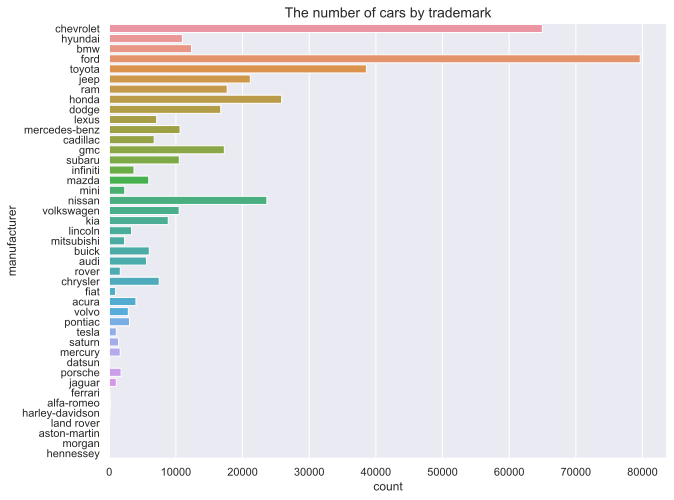

In [14]:
%config InlineBackend.figure_format = 'svg' 

from pylab import rcParams
sns.set(rc={'figure.figsize':(10, 8)})

ax = sns.countplot(data=new_data, y='manufacturer')
ax.set_title('The number of cars by trademark', fontsize = 14, fontname = 'Arial')

Ford, Chevrolet и Toyota составляют тройку лидеров на рынке продаж б/у автомобилей. 

Доля Форда на данном рынке составила: 17%

In [15]:
79666/new_data.shape[0]*100

17.386237404875025

In [16]:
new_data['manufacturer'].value_counts()

ford               79666
chevrolet          64977
toyota             38577
honda              25868
nissan             23654
jeep               21165
ram                17697
gmc                17267
dodge              16730
bmw                12352
hyundai            10975
mercedes-benz      10628
subaru             10510
volkswagen         10489
kia                 8854
chrysler            7499
lexus               7119
cadillac            6743
buick               6009
mazda               5931
audi                5583
acura               4008
infiniti            3714
lincoln             3338
pontiac             3037
volvo               2866
mini                2330
mitsubishi          2301
porsche             1779
rover               1662
mercury             1645
saturn              1393
tesla               1067
jaguar              1060
fiat                 955
alfa-romeo           187
harley-davidson      139
ferrari               96
datsun                63
aston-martin          35


Text(0.5, 1.0, 'Top trademarks')

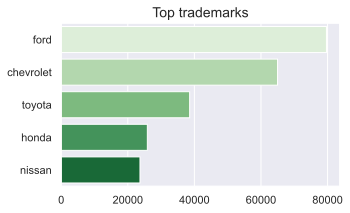

In [17]:
sns.set(rc={'figure.figsize':(5, 3)})
top =new_data['manufacturer'].value_counts()[0:5]
ax = sns.barplot(x=top.values, y=top.index, palette='Greens')
ax.set_title('Top trademarks', fontsize = 14, fontname = 'Arial')

Text(0.5, 1.0, 'Bottom trademarks')

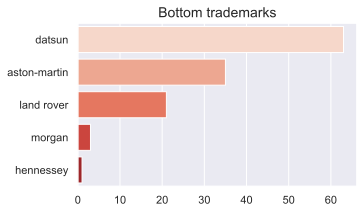

In [18]:
bott = new_data['manufacturer'].value_counts()[-5:]
ax = sns.barplot(x=bott.values, y=bott.index, palette='Reds')
ax.set_title('Bottom trademarks', fontsize = 14, fontname = 'Arial')

In [19]:
n = int(2020-1900)//10+1
bins = [0]*(n)
# создаем пустой список из n+1 элементов и наполняем его
for i in range(n):
        bins[i]=10*i+1900
new_data['year_bins'] = pd.cut(new_data['year'], bins)
bins

[1900, 1910, 1920, 1930, 1940, 1950, 1960, 1970, 1980, 1990, 2000, 2010, 2020]

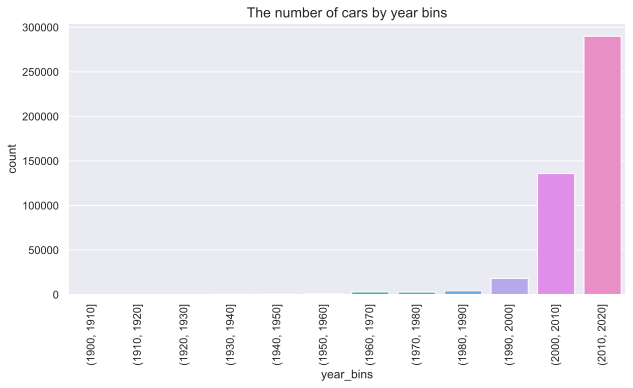

In [20]:
import matplotlib.pyplot as plt
sns.set(rc={'figure.figsize':(10, 5)})
ax = sns.countplot(data=new_data, x='year_bins')
ax.set_title('The number of cars by year bins', fontsize = 14, fontname = 'Arial')
plt.xticks(rotation = 90);

In [21]:
new_data['year'] = new_data['year'].replace(0, np.nan)
sns.relplot(
    data=new_data,
    x="year", y="condition")

Как и ожидалось,чем ближе год изготовления к периоду 2005-2015, тем выше плотность распределения.

In [22]:
new_data.describe()

,id,price,year,odometer
count,4.582130e+05,4.582130e+05,457163.000000,4.029100e+05
mean,7.235233e+09,4.042093e+04,2010.746067,1.016698e+05
std,4.594362e+06,8.194599e+06,8.868136,3.228623e+06
min,7.208550e+09,0.000000e+00,1900.000000,0.000000e+00
25%,7.231953e+09,4.900000e+03,2008.000000,4.087700e+04
50%,7.236409e+09,1.099500e+04,2013.000000,8.764100e+04
75%,7.239321e+09,2.149500e+04,2016.000000,1.340000e+05
max,7.241019e+09,3.615215e+09,2021.000000,2.043756e+09


In [45]:
top_type = new_data['type'].value_counts()[0:5]

In [46]:
top_type

sedan     92364
SUV       79882
pickup    43343
truck     35694
other     24160
Name: type, dtype: int64

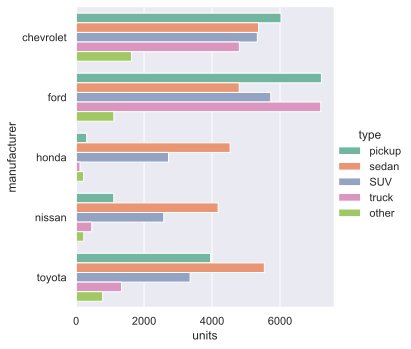

In [54]:
top_type = new_data["type"].value_counts()[0:5]

filter_cars=new_data[new_data["condition"].isin(["excellent", "good", "fair"])]
filter_cars = filter_cars[filter_cars["type"].isin(top_type.index)]

top=new_data["manufacturer"].value_counts()[0:5]
filter_top = filter_cars[filter_cars["manufacturer"].isin(top.index)]

(filter_top
.groupby("manufacturer")["type"]
.value_counts(normalize=False)
.rename('units')
.reset_index()
.pipe((sns.catplot,'data'), x="units",y='manufacturer',hue="type",kind='bar', palette='Set2'))

In [55]:
new_data['price'].mean()

40420.93069598637

In [56]:
new_data['price'].median()

10995.0

In [48]:
new_data = new_data.replace(0, np.nan)
new_data.query('20000<price<30000 & odometer<20000')

,id,url,region,price,year,manufacturer,model,condition,cylinders,fuel,odometer,type,paint_color,state
22,7235646387,https://auburn.craigslist.org/ctd/d/auburn-uni...,auburn,28990.0,2018.0,toyota,tacoma double cab sr5,good,6 cylinders,gas,17117.0,pickup,black,al
38,7233191380,https://auburn.craigslist.org/ctd/d/san-rafael...,auburn,29988.0,2019.0,lexus,nx 300 f sport,excellent,4 cylinders,gas,18022.0,SUV,NaN,al
48,7230930424,https://auburn.craigslist.org/ctd/d/auburn-uni...,auburn,22990.0,2012.0,ford,mustang gt premium,good,8 cylinders,gas,18698.0,convertible,silver,al
66,7227857419,https://auburn.craigslist.org/ctd/d/auburn-uni...,auburn,25990.0,2019.0,ford,f150 regular cab xl pickup,good,8 cylinders,gas,5439.0,pickup,white,al
67,7227394599,https://auburn.craigslist.org/ctd/d/auburn-uni...,auburn,28990.0,2018.0,toyota,tacoma double cab sr5,good,6 cylinders,gas,17499.0,pickup,grey,al
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
457958,7240977397,https://greenbay.craigslist.org/ctd/d/green-ba...,green bay,21590.0,2018.0,gmc,acadia sle-1 sport utility,good,NaN,gas,19802.0,other,black,wi
458028,7240958130,https://lacrosse.craigslist.org/ctd/d/la-cross...,la crosse,22990.0,2015.0,chevrolet,silverado 1500 regular,good,6 cylinders,other,12411.0,pickup,red,wi
458034,7241010660,https://madison.craigslist.org/ctd/d/madison-2...,madison,22590.0,2018.0,chevrolet,colorado extended cab,good,NaN,gas,18278.0,pickup,NaN,wi
458130,7241012952,https://milwaukee.craigslist.org/ctd/d/milwauk...,milwaukee,29990.0,2019.0,mazda,mx-5 miata rf club,good,NaN,gas,5038.0,other,red,wi


## Вывод

Всего на сервисе Craigslist в США продаются машины 43-х различных производителей. Наиболее распространенными б/у машинами выставленными на продажу являются машины компаний Ford, Chevrolet, Toyota, Honda, Nissan. Машины таких марок, как  Datsun, Aston-martin, Land rover, Morgan, Hennessey реже всего встречаются на рынке, их общее количество не превышает 150 штук. Все-таки большинство машин выставлены с годом производства, который попадает в интервал последнего десятилетия(2010-2020). В каталоге имеются и раритетные машины, самая старая была выпущена в 1900 году компанией Ford. Наибольшее долю рынка занимают  машины класса SUV и седан. Однако среди лидеров по маркам автомобилей у Chevrolet pickup – лидирующая строка продаж, у Ford – pickup и truck, у остальных топ-производителей рынка продаж б/у автомобилей машины класса sedan выставлены на продажу в большем объеме, чем машины других классов. Средняя цена, выставленных машин составляет 40420$